In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.ticker as mtick
import matplotlib.dates as mdates

import urllib.request, json 

# Country by JHU

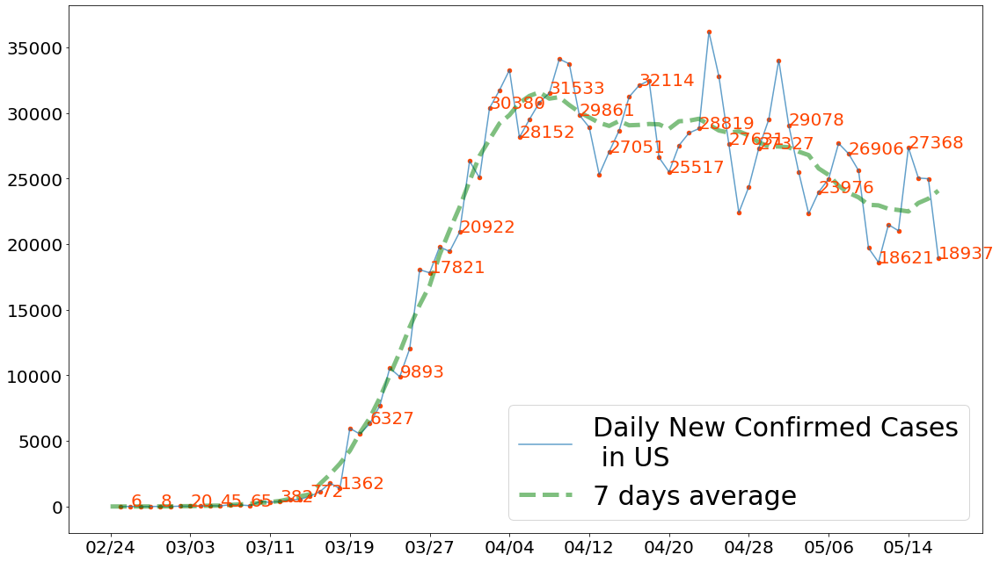

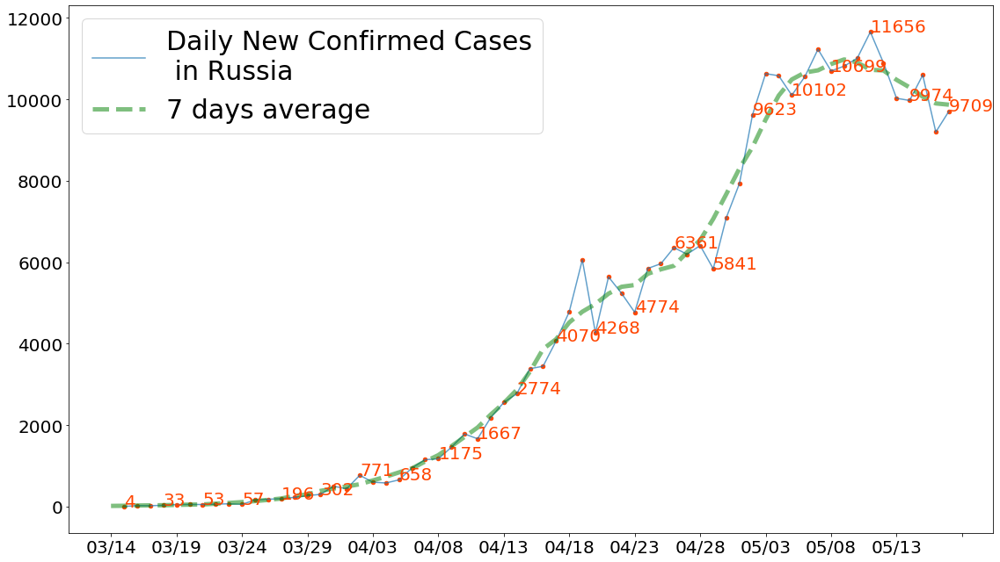

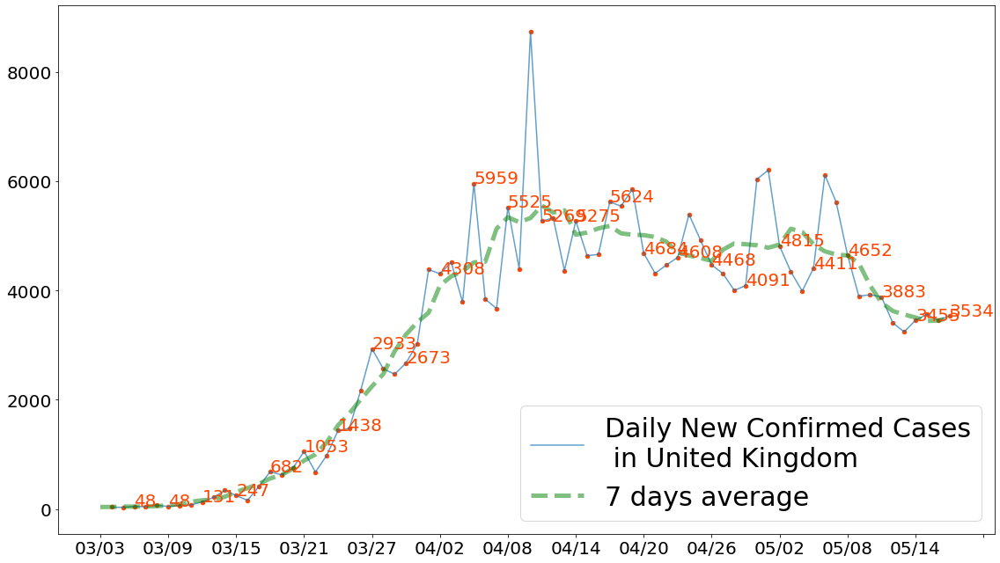

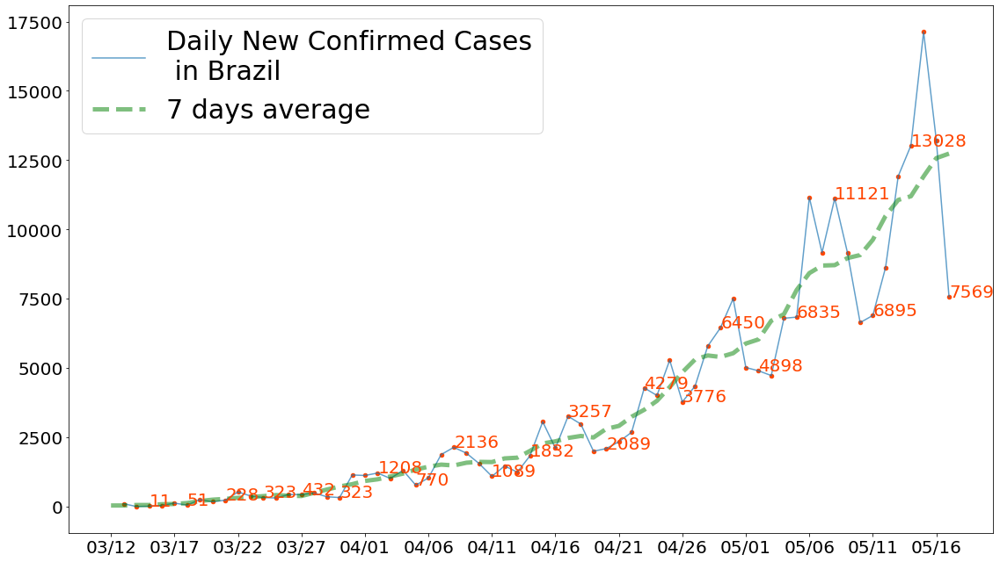

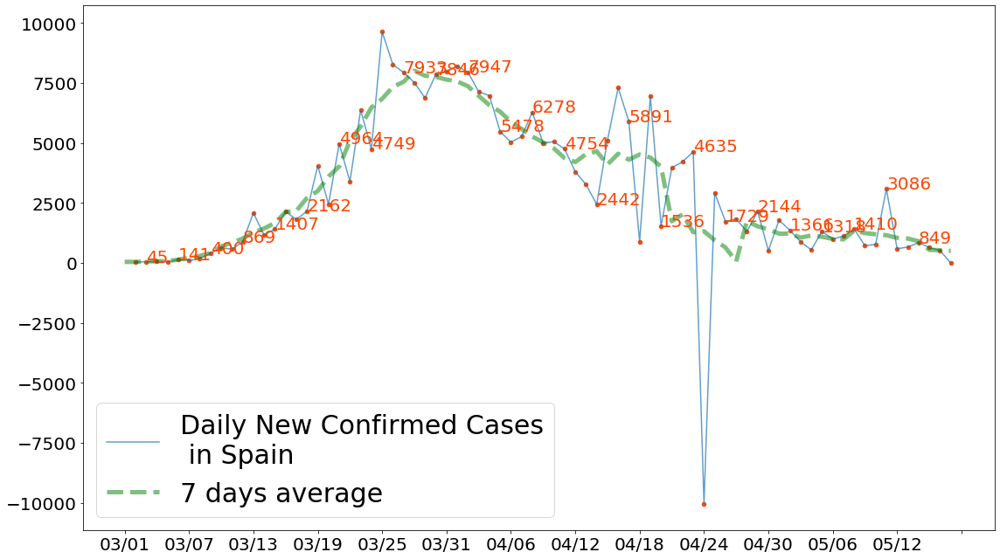

...

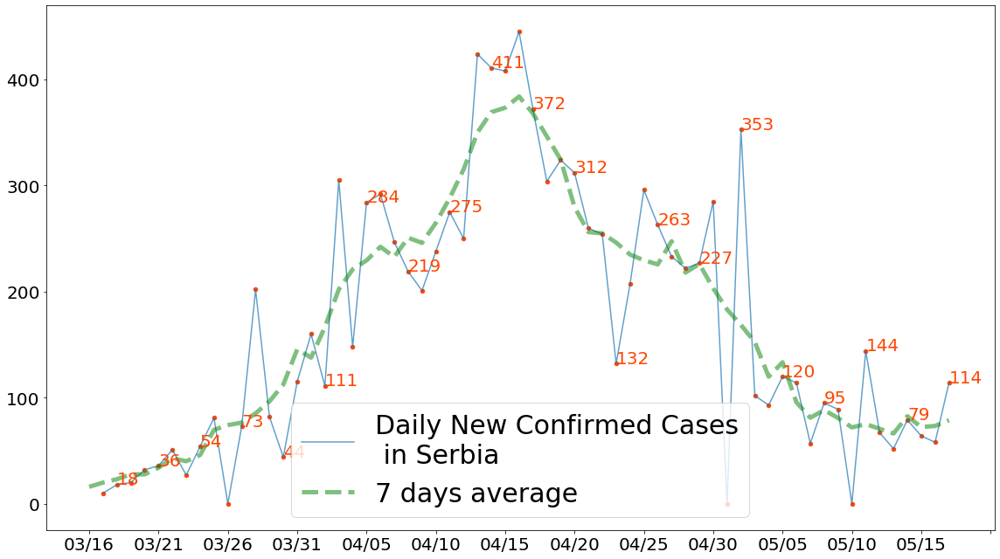

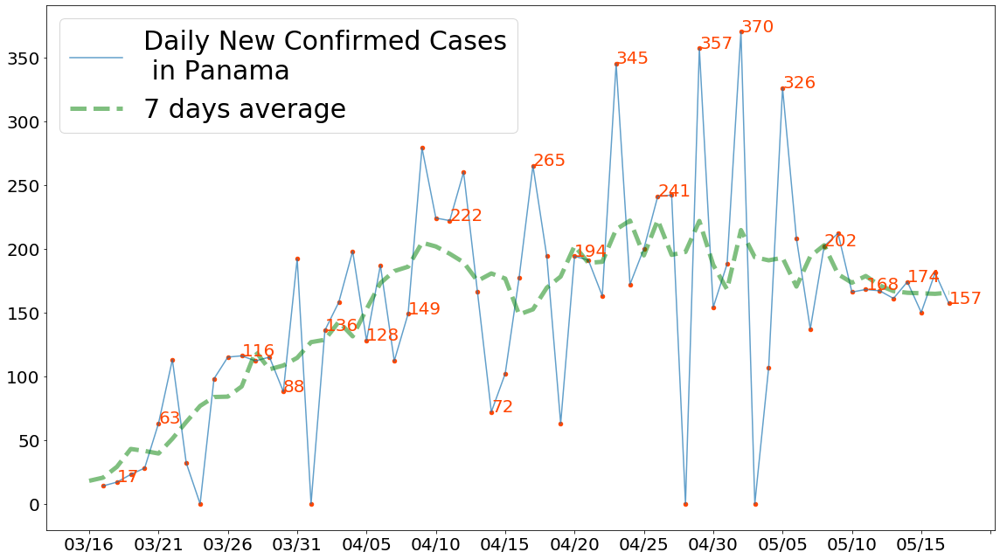

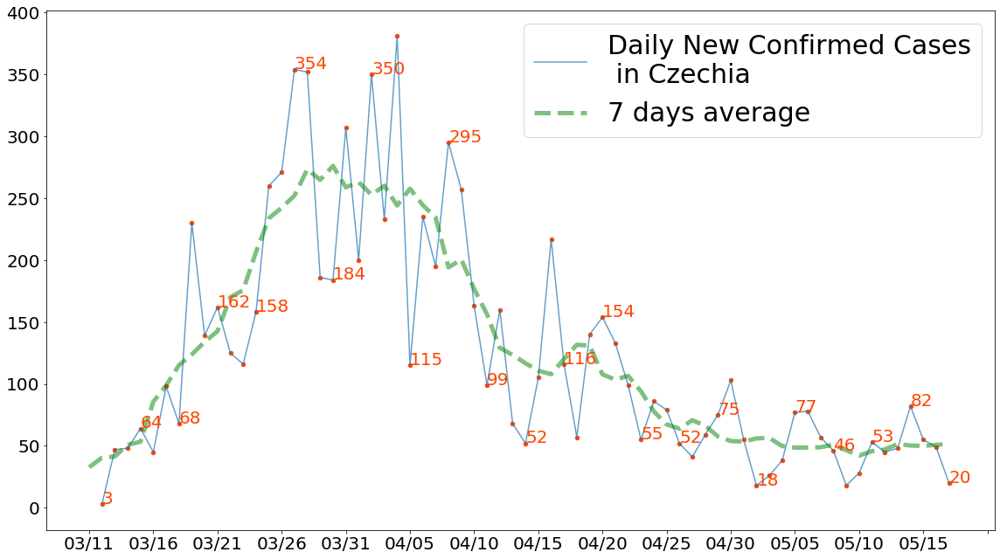

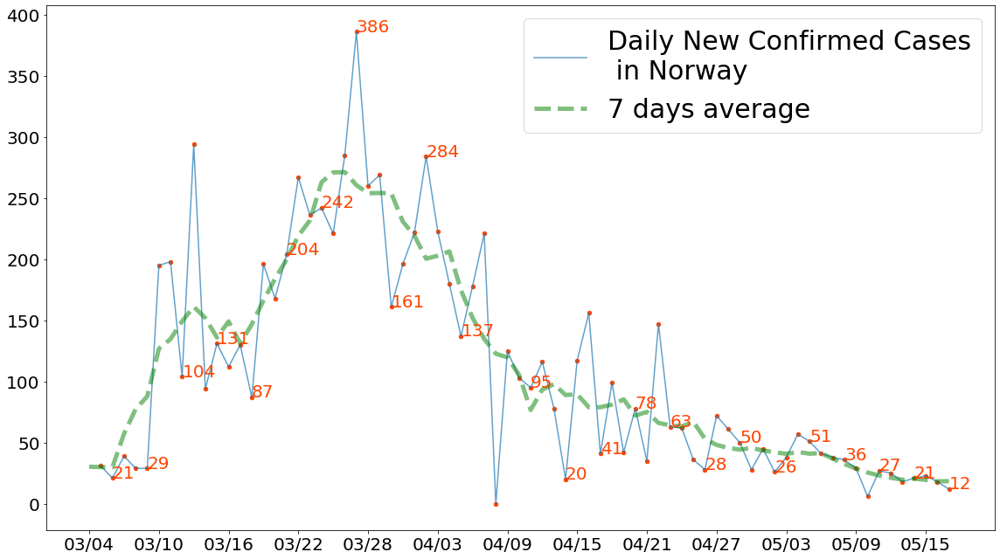

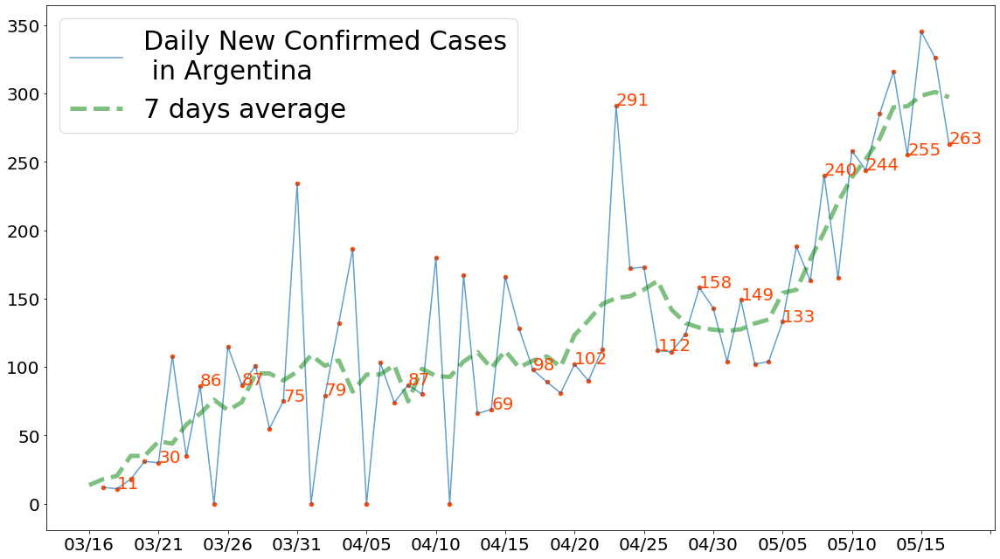

In [7]:
confirm = pd.read_csv('data/JH/confirm_agg.csv').set_index('Country/Region').T
confirm['time'] = pd.to_datetime(confirm.index)
confirm.index = confirm.time.dt.strftime('%m/%d')
confirm.drop('time', axis=1, inplace=True)

# offset = 35
for country in confirm.iloc[-1].sort_values(ascending=False).index[:50]:
    offset = np.argmax(confirm[country].values >= 50)
    focus =  confirm.loc[:,[country]].copy()[offset:]
    focus['new'] = focus[country] - focus[country].shift(1)
    
    fig, ax=plt.subplots(nrows=1, ncols=1, figsize=(16,9))
    ax.plot(focus.index, focus.new, label='Daily New Confirmed Cases\n in ' + country, alpha=0.7)
    ax.scatter(focus.index, focus.new, c='orangered',s=20, label='')

    window = 7
    focus['average'] = focus['new'].rolling(window=window, min_periods=1, center=True).mean()
    ax.plot(focus.index, focus.average, 'g--', lw=5, alpha=0.5, label='%d days average'%window)
#     ax.plot(focus.index, focus['new'].rolling(7,win_type='gaussian',min_periods=1,center=True).mean(std=2).round()
#             , 'b--', lw=5, alpha=0.5, label='%d days average'%window)
    
    for i, v in enumerate(focus.new):
        if v > 0 and (len(focus)-i)%3 == 1:
            ax.text(i, v+0.3, str(int(v)), color='orangered', fontsize=20)

    # ax.set_yscale('log')
    ax.tick_params(labelsize=20)
    ax.legend(fontsize=30)

    plt.tight_layout()
    ax.xaxis.set_major_locator(plt.MaxNLocator(15))
#     plt.savefig(r'figures/%s.png'% (country+date), dpi=600)
    plt.show()
plt.close()

# US states by NYT

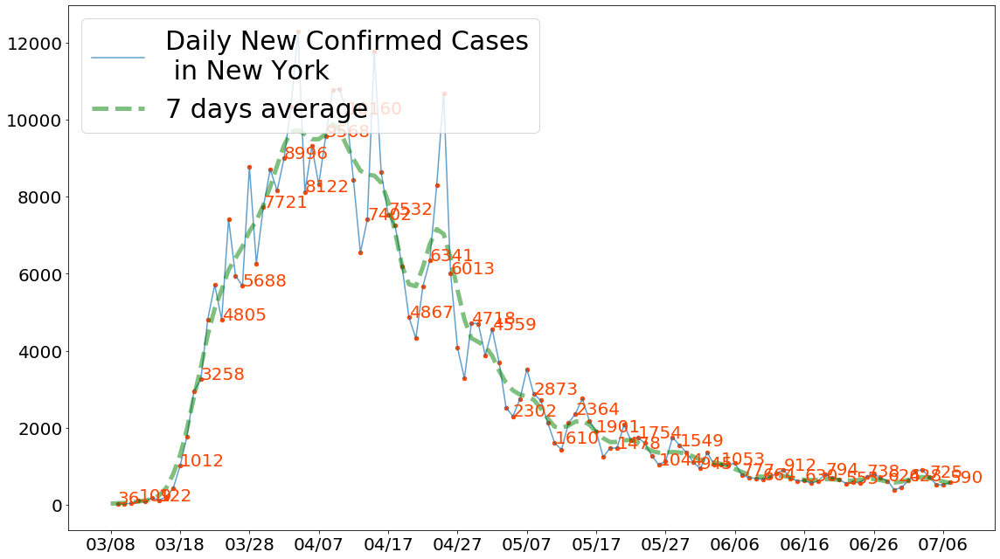

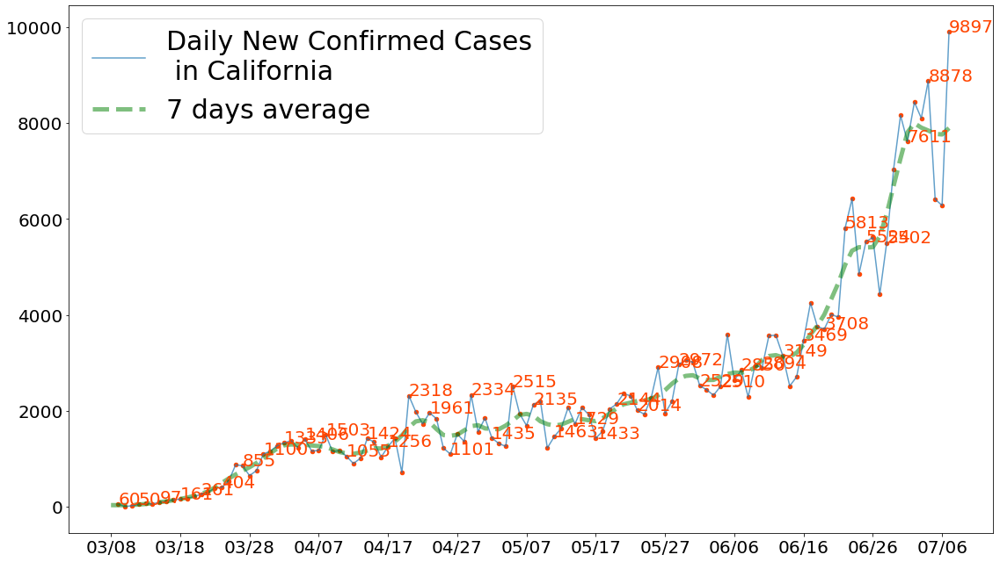

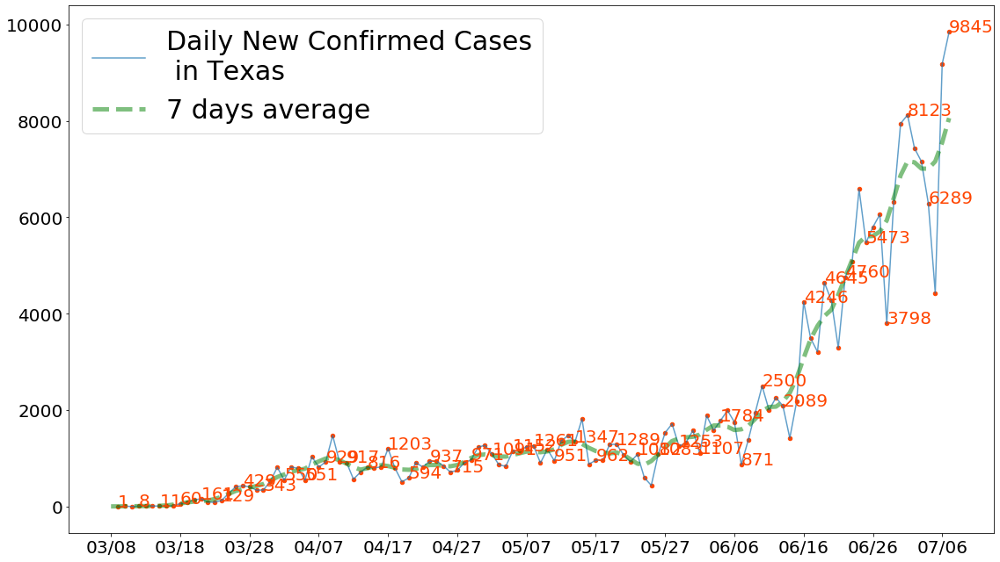

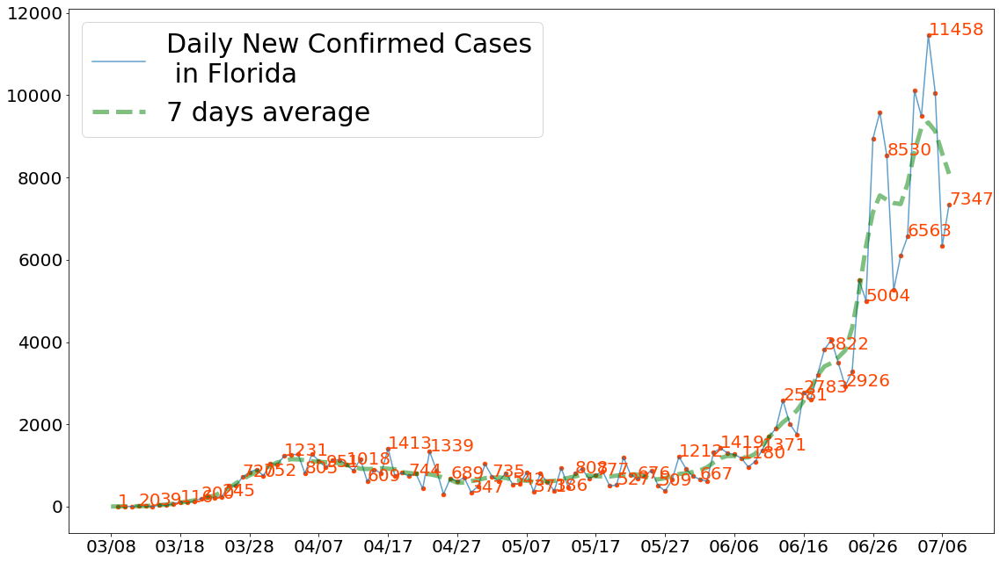

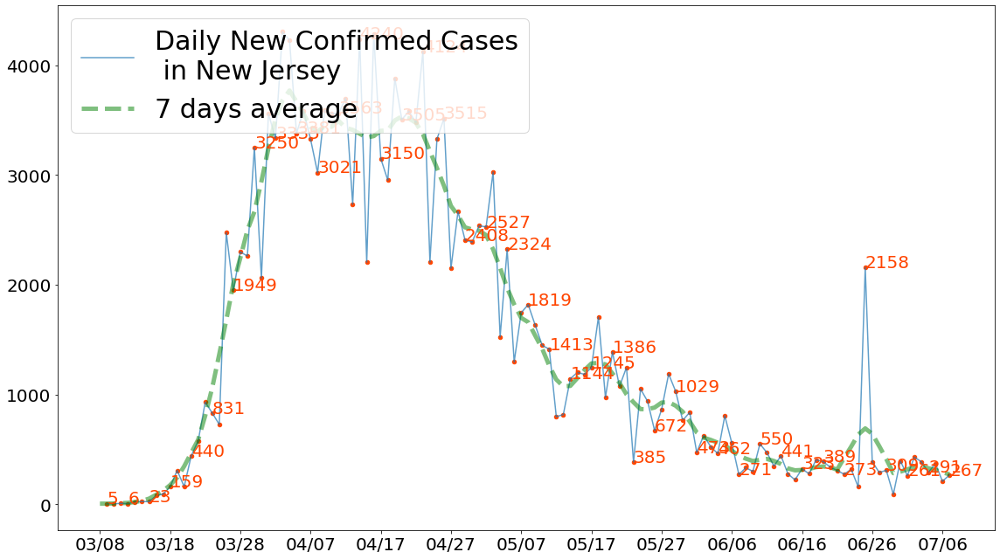

...

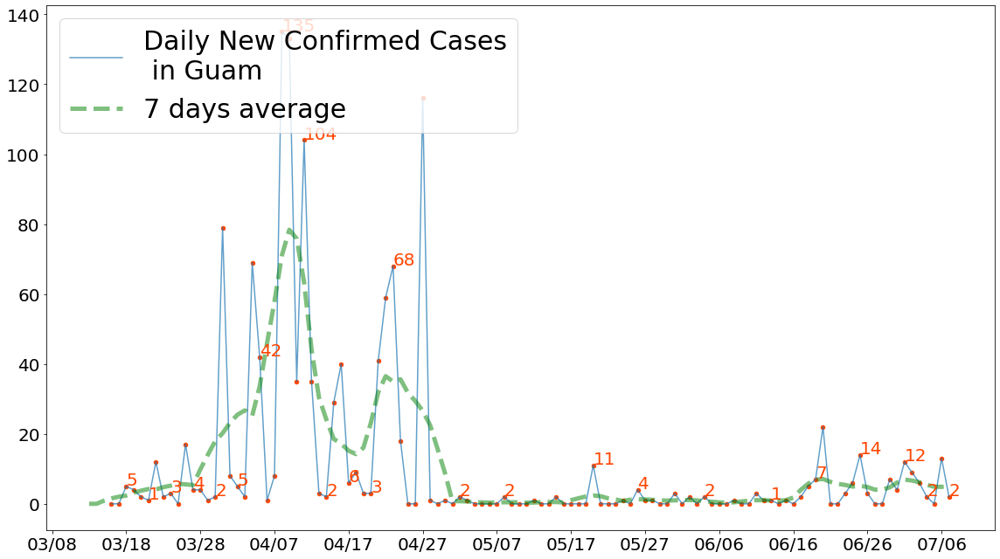

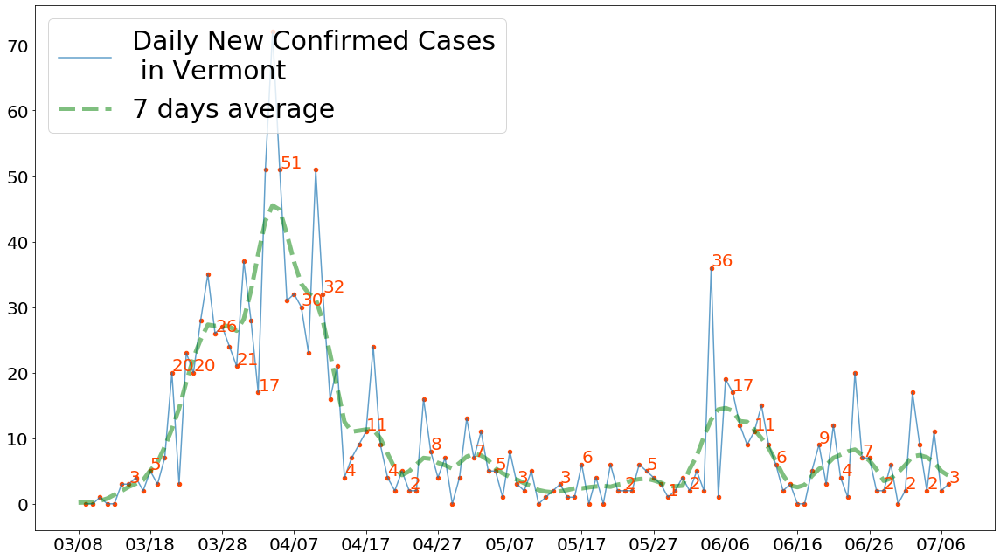

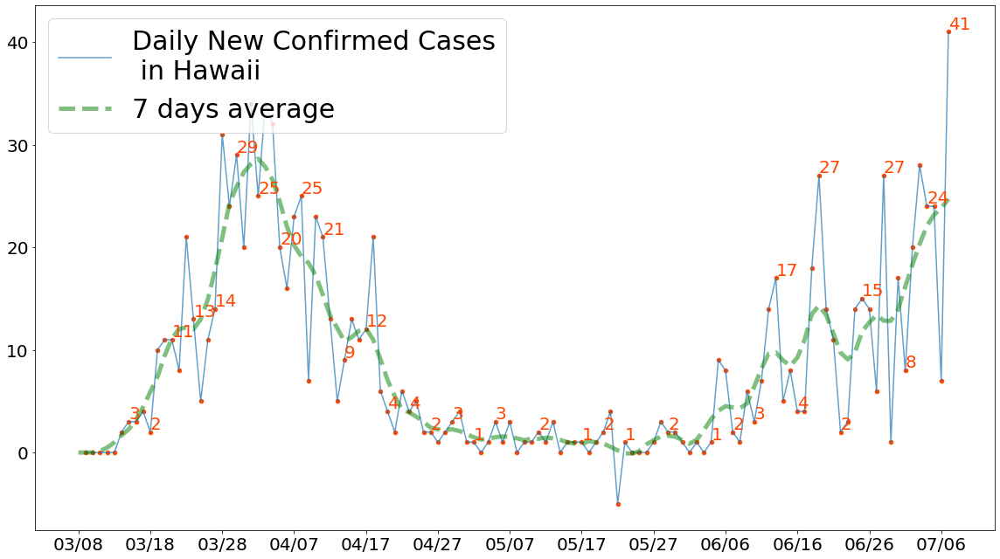

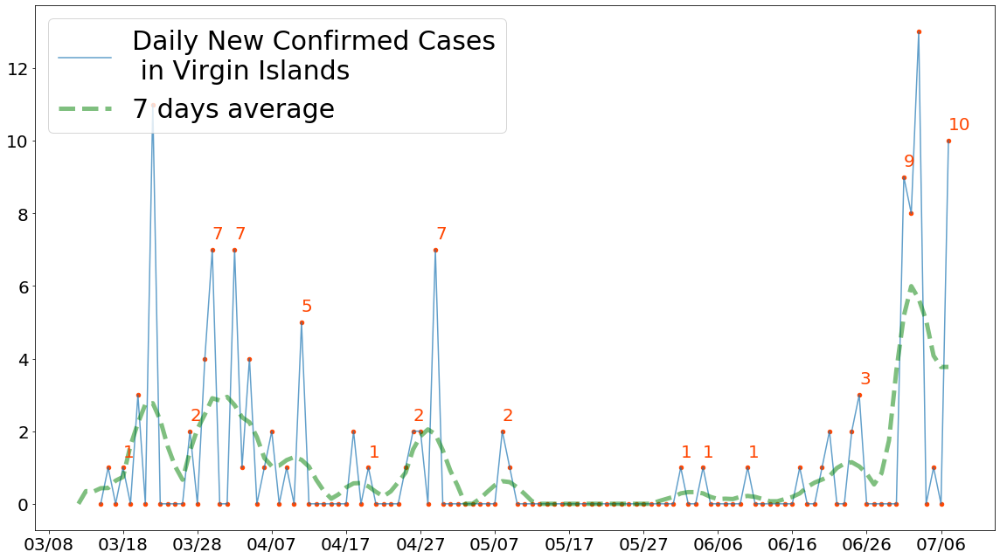

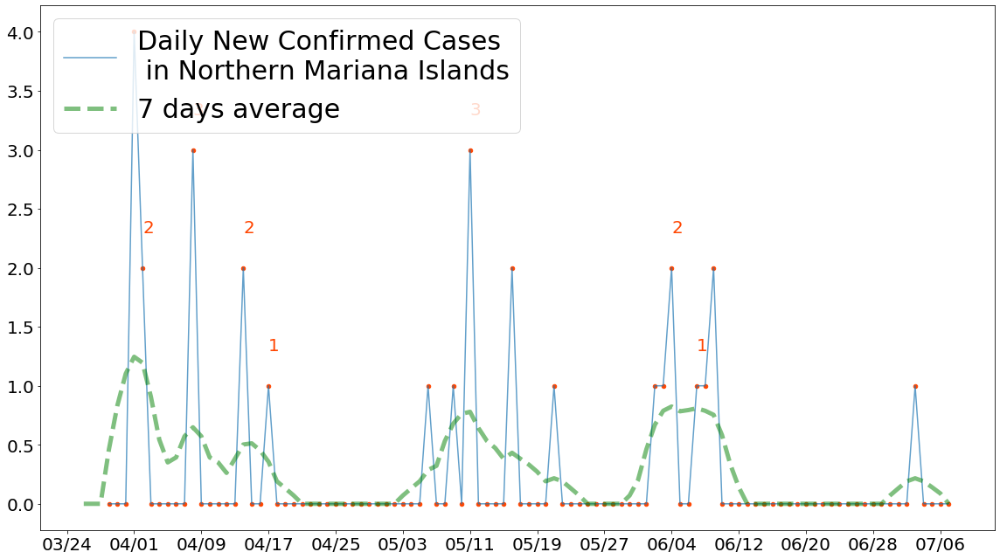

In [3]:
df = pd.read_csv('data/Country detailed/US by state.csv').set_index('date')
df['time'] = pd.to_datetime(df.index)
df.index = df.time.dt.strftime('%m/%d')
df.drop('time', axis=1, inplace=True)

offset = 15
for country in df.iloc[-1].sort_values(ascending=False).index[:]:

    focus =  df.loc[:,[country]].copy()[offset: ]
    focus['new'] = focus[country] - focus[country].shift(1)

    fig, ax=plt.subplots(nrows=1, ncols=1, figsize=(16,9))
    ax.plot(focus.index, focus.new, label='Daily New Confirmed Cases\n in ' + country, alpha=0.7)
    ax.scatter(focus.index, focus.new, c='orangered',s=20, label='')

    window = 7
    focus['average'] = focus['new'].rolling(window=window, win_type='gaussian',min_periods=1, center=True).mean(std=2)
    ax.plot(focus.index, focus.average, 'g--', lw=5, alpha=0.5, label='%d days average'%window)

    for i, v in enumerate(focus.new):
        if v > 0 and v not in [5974,4050,5210,4668,3590,9320, 6549] and (len(focus)-i)%3 == 1:
            ax.text(i, v+0.3, str(int(v)), color='orangered', fontsize=20)

    # ax.set_yscale('log')
    ax.tick_params(labelsize=20)
    ax.legend(loc="upper left", fontsize=30)

    plt.tight_layout()
    ax.xaxis.set_major_locator(plt.MaxNLocator(15))
    plt.show()
#     plt.savefig(r'figures/%s.png'% (country+date), dpi=600)
plt.close()

# US states by COVIDtracking

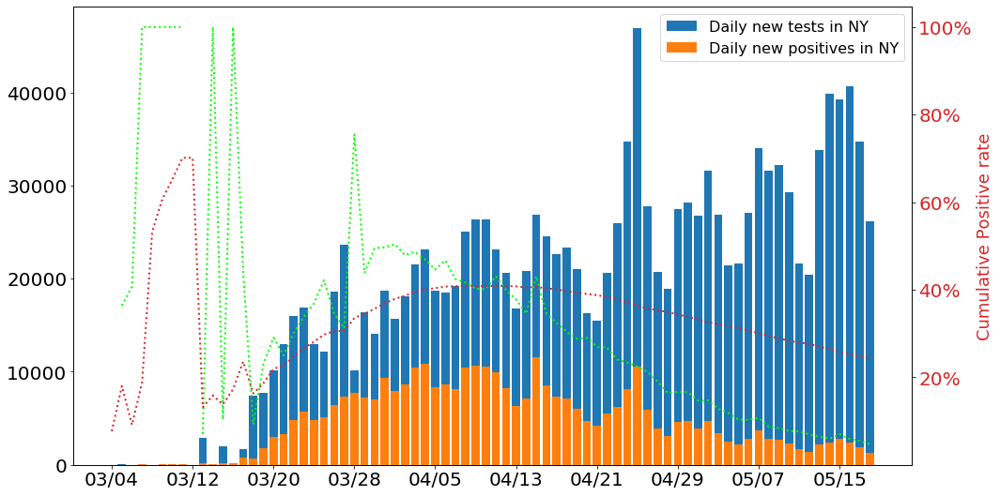

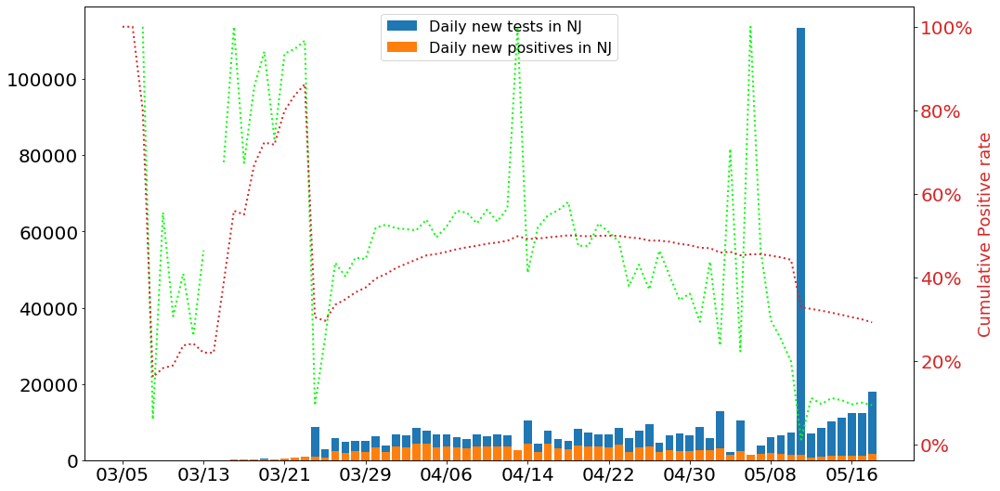

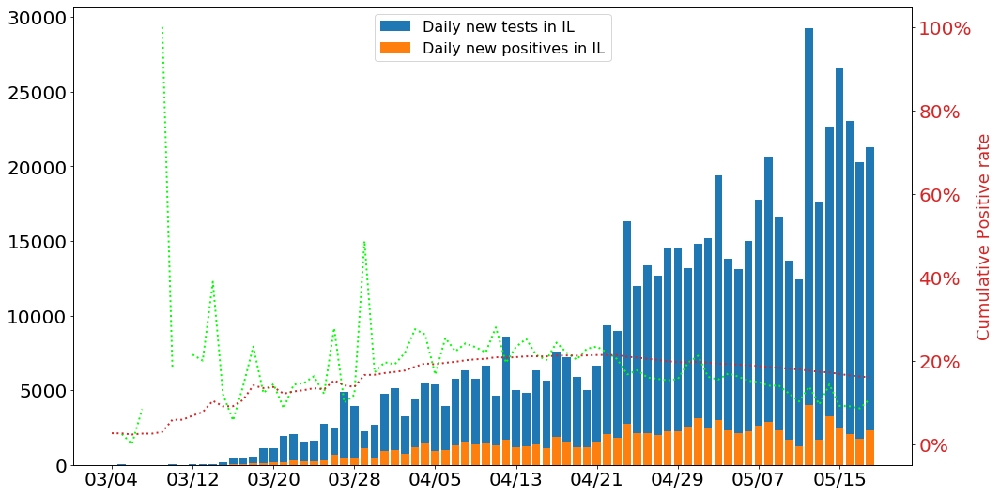

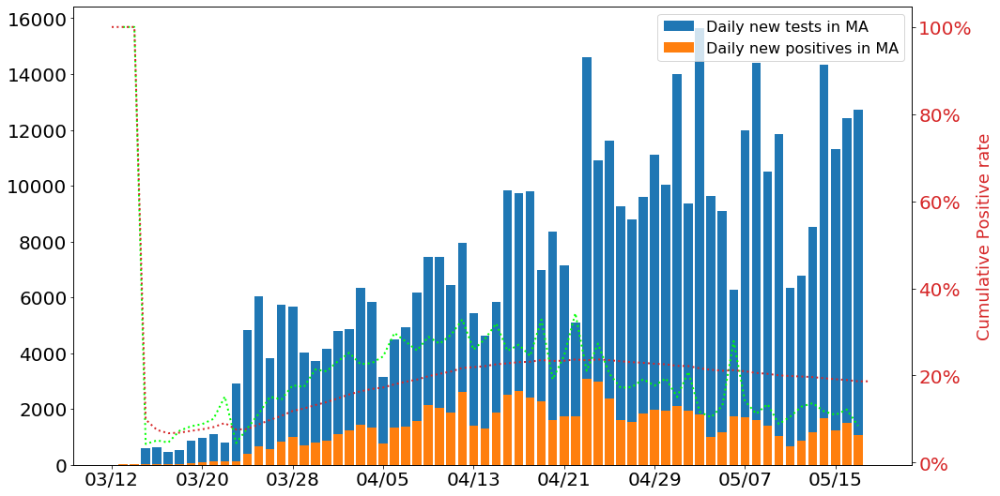

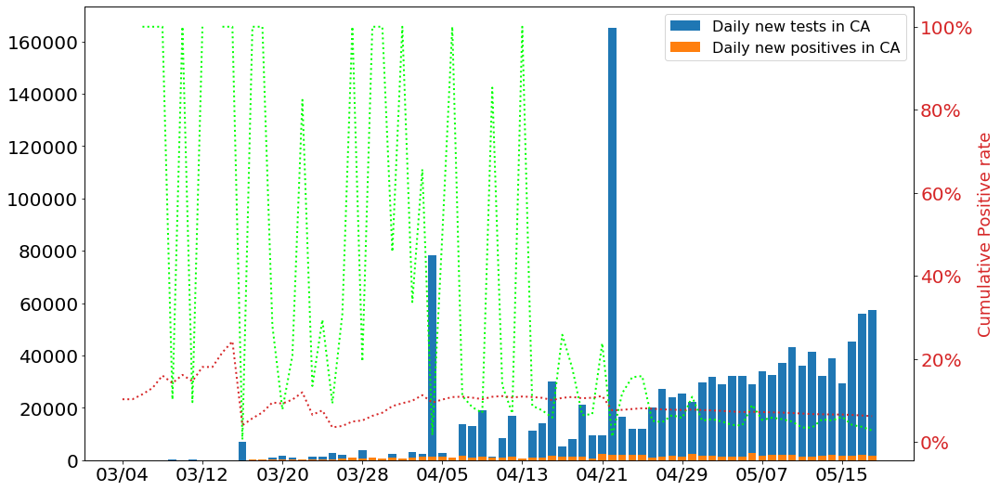

...

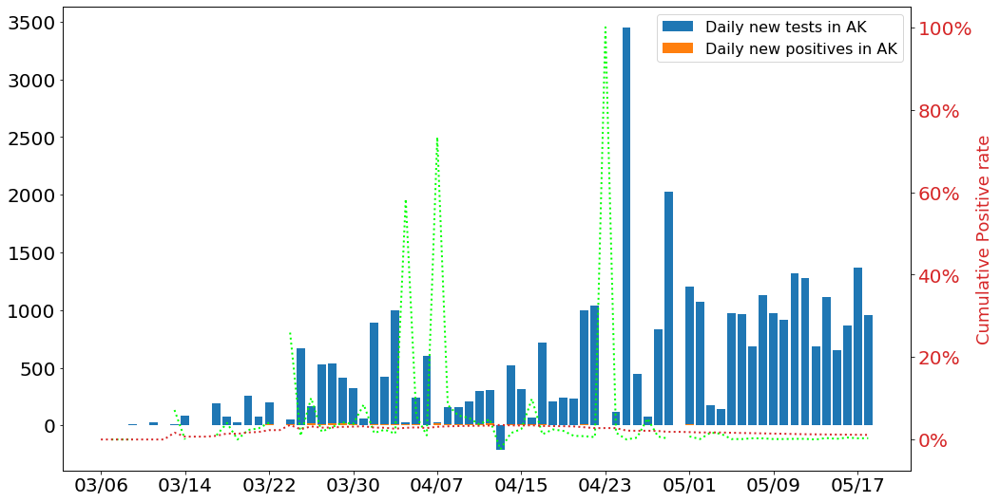

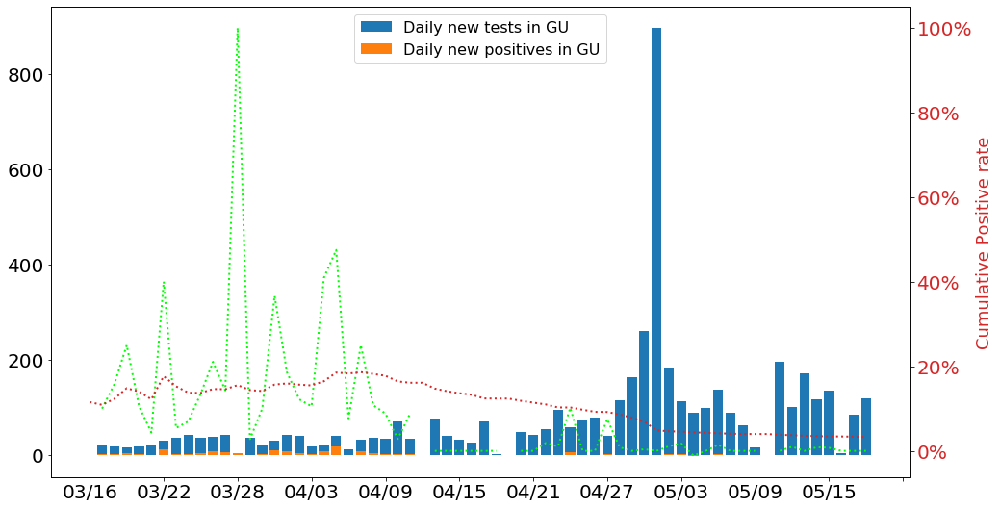

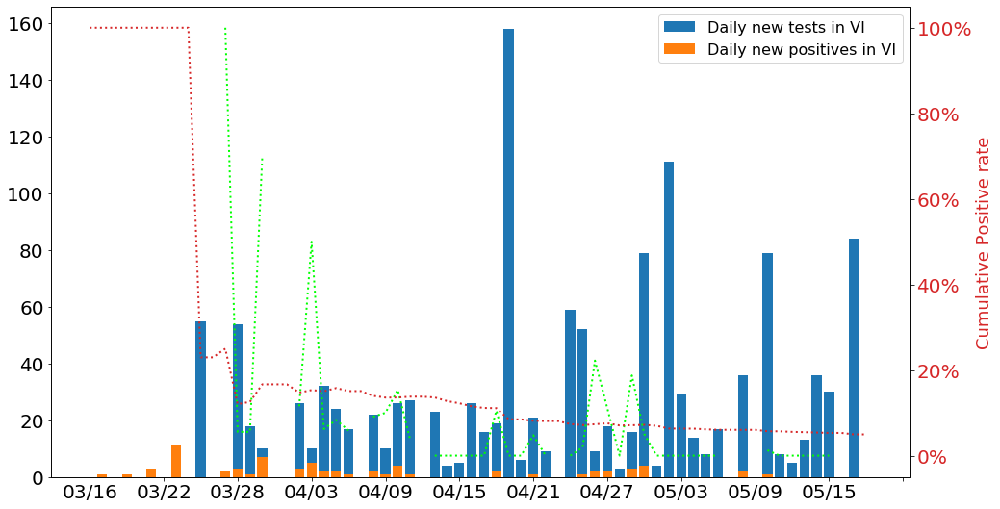

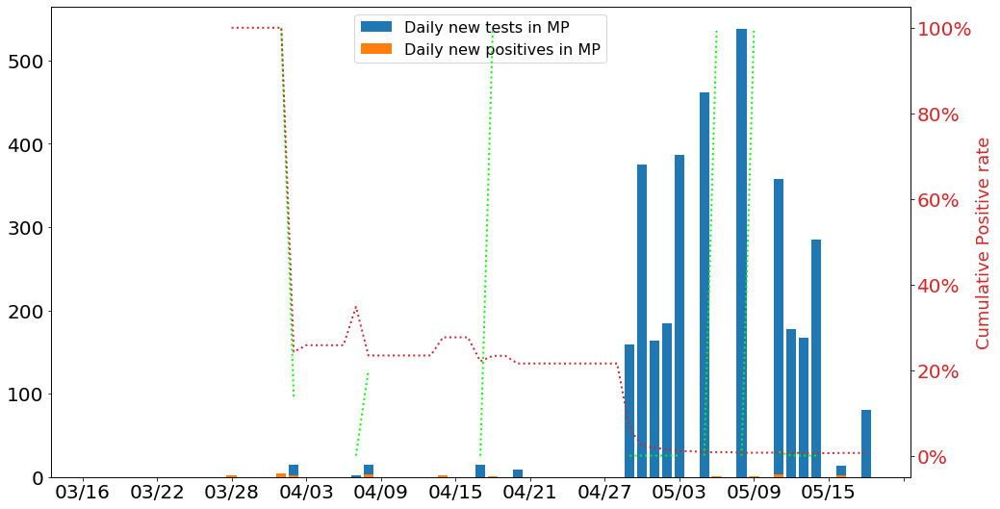

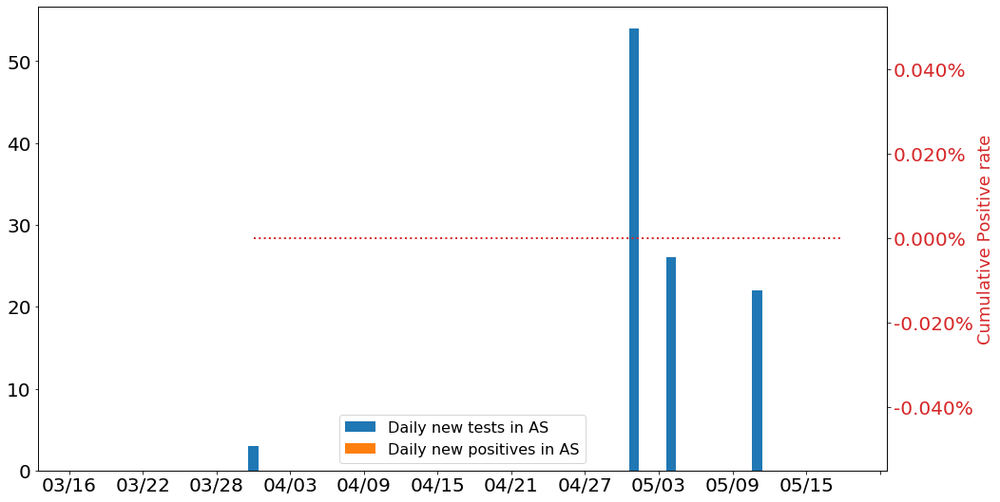

In [12]:
with urllib.request.urlopen("https://covidtracking.com/api/v1/states/daily.json") as url:
    data = json.loads(url.read().decode())
df = pd.DataFrame(data)
df['date'] = pd.to_datetime(df.date, format='%Y%m%d')
df.iloc[0]['date']

for focus_state in df[df['date']==df['date'][0]].sort_values('positive', ascending=False)['state']:
    focus = df[df['state']==focus_state].set_index('date').sort_index()
    focus['time'] = pd.to_datetime(focus.index, format='%Y%m%d')
    focus.index = focus.time.dt.strftime('%m/%d')


    fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(16,9))

    ax.bar(x=focus.index, height=focus['totalTestResultsIncrease'],label='Daily new tests in '+focus_state)
    ax.bar(x=focus.index, height=focus['positiveIncrease'],label='Daily new positives in '+focus_state)
    ax.legend(fontsize=16)

    ax2 = ax.twinx()
    color = 'tab:red'
    ax2.set_ylabel('Cumulative Positive rate', color=color, fontsize=18)
    ax2.plot(focus['positiveIncrease']/focus['totalTestResultsIncrease']*100, ls=':', lw=2, color='lime')
    ax2.plot(focus['positive']/focus['total']*100, ls=':', lw=2, color=color)
    ax2.tick_params(axis='y', labelcolor=color)
    ax2.yaxis.set_major_formatter(mtick.PercentFormatter())
    ax.tick_params(labelsize=20)
    ax2.tick_params(labelsize=20)
    ax.xaxis.set_major_locator(plt.MaxNLocator(12))
    plt.show()
plt.close()

# Global mobility

In [142]:
df = pd.read_csv('https://www.gstatic.com/covid19/mobility/Global_Mobility_Report.csv')
df['date'] = pd.to_datetime(df.date)
df.index = df.date.dt.strftime('%m/%d')
df.drop('date', axis=1, inplace=True)

D:\Anaconda\lib\site-packages\IPython\core\interactiveshell.py:3063: DtypeWarning: Columns (3) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [143]:
mobility = df[(df['sub_region_1'].isnull()) & (df['sub_region_2'].isnull())]
mobility = mobility.replace({'United States':'US',
                             'South Korea':'Korea, South',
                            'The Bahamas':'Bahamas',
                            'Cape Verde':'Cabo Verde',
                            "Côte d'Ivoire":"Cote d'Ivoire",
                            'Myanmar (Burma)':'Burma'})

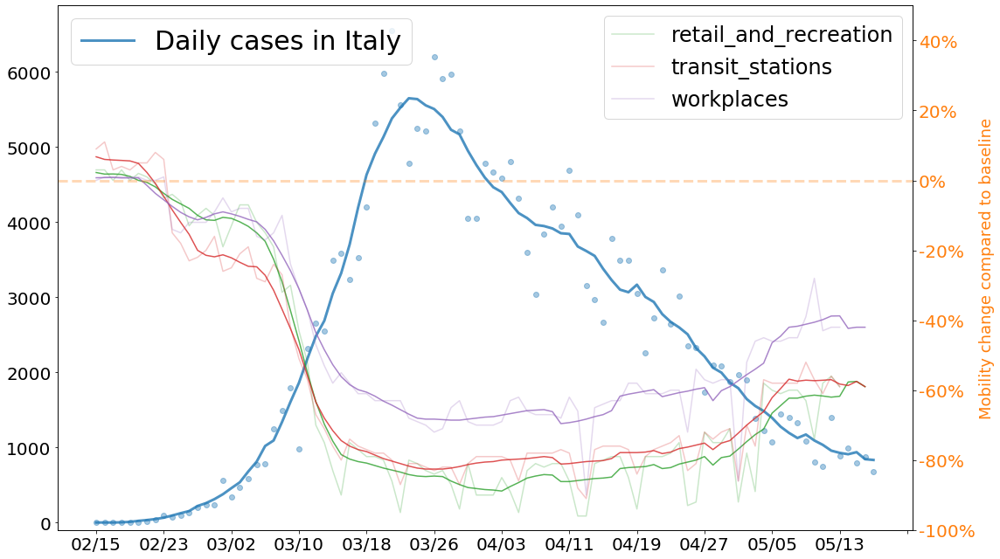

In [150]:
country = 'Italy'
temp = mobility[mobility['country_region']==country].drop(['country_region','country_region_code','sub_region_1','sub_region_2',
                                                          'parks_percent_change_from_baseline',
                                                           'residential_percent_change_from_baseline',
                                                           'grocery_and_pharmacy_percent_change_from_baseline',],
                                                         axis=1).copy()
focus = confirm.diff()[[country]].merge(temp, left_on=confirm.index, right_on=temp.index, how='left').set_index('key_0')
focus = focus.iloc[focus.index.get_loc('02/15'):]

fig, ax=plt.subplots(nrows=1, ncols=1, figsize=(16,9))

ax.plot(focus[country],'o',c='C0',alpha=0.4)
ax.plot(focus[country].rolling(window=7, min_periods=1, center=True).mean(),c='C0',lw=3, label='Daily cases in %s'%country, alpha=0.8)

ax.tick_params(labelsize=20)
ax.legend(loc='upper left', fontsize=30)
ax.format_xdata = mdates.DateFormatter('%m-%d')
ax.xaxis.set_major_locator(plt.MaxNLocator(15))
ax.set_ylim(bottom=-100)

ax2 = ax.twinx()
for i, category in enumerate(list(focus)[1:]):
    ax2.plot(focus[category], label=category.split('_per')[0], c='C'+str(i+2), alpha=0.25)
    ax2.plot(focus[category].rolling(window=7, min_periods=1, center=True).mean(), c='C'+str(i+2),alpha=0.8)

#     ax2.plot(temp.index, temp[i].rolling(window=7, min_periods=1, center=True).mean(),label=i.split('_percent')[0])

ax2.legend(fontsize=24)
ax2.set_ylabel('Mobility change compared to baseline', color='C1', fontsize=18)
ax2.axhline(y=0, c='C1',lw=3, ls='--',alpha=0.3)
ax2.tick_params(axis='y', labelcolor='C1')
ax2.yaxis.set_major_formatter(mtick.PercentFormatter())
ax2.tick_params(labelsize=20)
ax2.xaxis.set_major_locator(plt.MaxNLocator(15))
ax2.set_ylim(bottom=-100, top=50)

plt.tight_layout()
# plt.show()
plt.savefig('figures/Daily_misc_5_20g.png',dpi=600)

# US states mobility

In [151]:
df = pd.read_csv('https://www.gstatic.com/covid19/mobility/Global_Mobility_Report.csv')
df['date'] = pd.to_datetime(df.date)
df.index = df.date.dt.strftime('%m/%d')
df.drop('date', axis=1, inplace=True)

mobility = df[(df['country_region_code'] == 'US') & (~df['sub_region_1'].isnull()) & (df['sub_region_2'].isnull())]
mobility.drop(['country_region_code','country_region','sub_region_2',
              'parks_percent_change_from_baseline',
               'residential_percent_change_from_baseline',
               'grocery_and_pharmacy_percent_change_from_baseline',
              ], axis=1, inplace=True)

df = pd.read_csv('https://raw.githubusercontent.com/nytimes/covid-19-data/master/us-states.csv')
df['date'] = pd.to_datetime(df.date)
df.index = df.date.dt.strftime('%m/%d')
df.drop('date', axis=1, inplace=True)

cases = df.pivot(columns='state',values='cases').diff().iloc[25:]

policy = pd.read_csv('https://raw.githubusercontent.com/COVID19StatePolicy/SocialDistancing/master/data/USstatesCov19distancingpolicy.csv',
           encoding = "ISO-8859-1")

D:\Anaconda\lib\site-packages\pandas\core\frame.py:3997: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


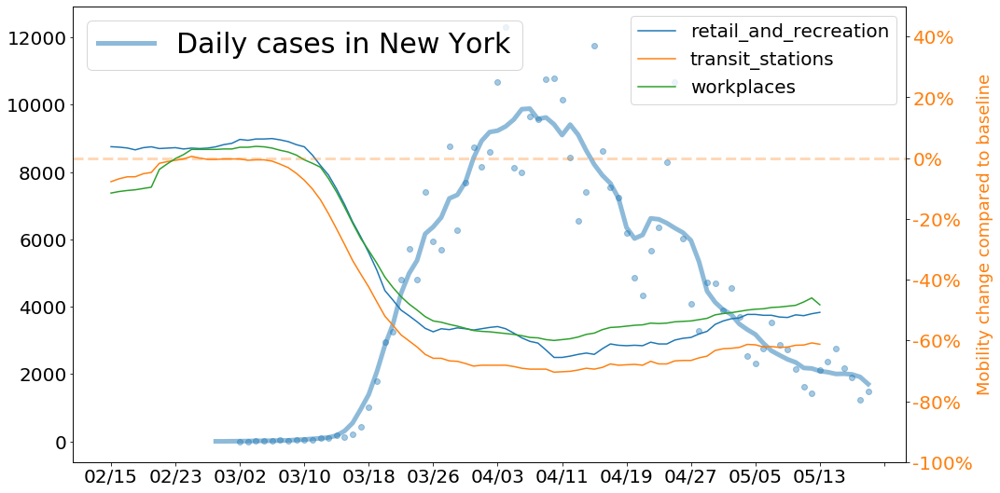

In [153]:
# for state in [state for state in cases.sum().sort_values(ascending=False).index if state in mobility['sub_region_1'].unique()]:
state = 'New York'
category = 'retail_and_recreation_percent_change_from_baseline'

fig, ax=plt.subplots(nrows=1, ncols=1, figsize=(16,9))

ax.plot(cases[state],'o',c='C0',alpha=0.4)
ax.plot(cases[state].rolling(window=7, min_periods=1, center=True).mean(),c='C0',lw=5, label='Daily cases in %s'%state, alpha=0.5)

ax.tick_params(labelsize=20)
ax.legend(loc=0, fontsize=30)
ax.format_xdata = mdates.DateFormatter('%m-%d')
ax.xaxis.set_major_locator(plt.MaxNLocator(15))
# ax.tick_params(rotation=90,labelsize=20)

ax2 = ax.twinx()
temp = mobility[mobility['sub_region_1']==state].copy()
# ax2.plot(temp.index, temp[category],c='C1')
for i in list(temp)[1:]:
    ax2.plot(temp.index, temp[i].rolling(window=7, min_periods=1, center=True).mean(),label=i.split('_percent')[0])

ax2.legend(fontsize=20)
ax2.set_ylabel('Mobility change compared to baseline', color='C1', fontsize=18)
ax2.axhline(y=0, c='C1',lw=3, ls='--',alpha=0.3)
ax2.tick_params(axis='y', labelcolor='C1')
ax2.yaxis.set_major_formatter(mtick.PercentFormatter())
ax2.tick_params(labelsize=20)
ax2.xaxis.set_major_locator(plt.MaxNLocator(15))
ax2.set_ylim(bottom=-100, top=50)

#     plt.tight_layout()
#     plt.show()
plt.savefig('figures/Daily_misc_5_20h.png',dpi=600)
    